In [38]:
import os
import sys
import pandas as pd
sys.path.append("..")
sys.path.append(".")
import seaborn as sns

cwd = os.getcwd()
sys.path.insert(0, cwd)
from src.h_utils import *
from src.h_darts import *
from src.h_geo import *


In [8]:
current_directory = os.getcwd()
interrim_path = "c:\\Users\\Andreas Langholz\\Yieldcaster\\data\\" + "interrim/"
process_path = "c:\\Users\\Andreas Langholz\\Yieldcaster\\data\\" + "processed/"

In [46]:
import matplotlib.pyplot as plt
def plot_col():
    plt.rc('font', size=13) 
    fig = plt.figure(figsize=(15, 10))
    ax  = fig.add_subplot(1, 1, 1)
    ax.tick_params(axis='x', colors='black')
    ax.tick_params(axis='y', colors='black')
    ax.yaxis.label.set_color('black')
    ax.xaxis.label.set_color('black')
    ax.xaxis.set_label('black')
    ax.title.set_color('black')


In [10]:
TARGET = ['yield']
CROPS = ['wheat_winter', 'wheat_spring', 'rice', 'maize', 'soy']    # set to target crops

df_target = pd.read_csv(process_path + 'df_train_target.csv', index_col=0)    
df_target = df_target[df_target.crop.isin(CROPS)]
yield_mask = pd.read_csv(interrim_path + 'yieldmask.csv', index_col=0)
df_target = df_target.merge(yield_mask, on=['lon', 'lat'], how='inner')
df_features = pd.read_csv(process_path + 'df_train_features_cruts.csv', index_col=0)
df_all = df_target.merge(df_features, on=['lon', 'lat', 'year'])


In [30]:
def get_var(df, var):
    vars = []
    for i in range(1,13):
        vars.append(var + str(i))
    df_out = df[['yield'] + vars]
    return df_out


<AxesSubplot:>

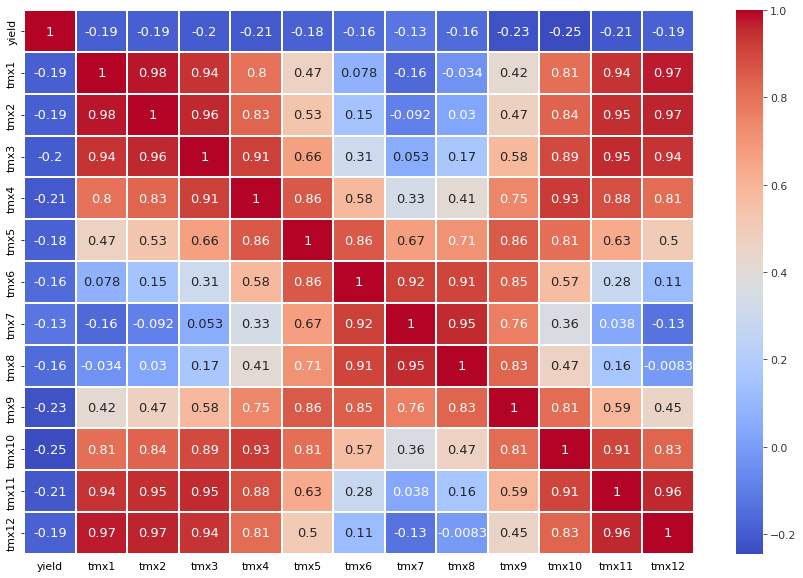

In [55]:
df_cor = df_all[df_all.crop == 'wheat_winter']
df_cor = get_var(df_cor, 'tmx')
plot_col()
sns.heatmap(df_cor.corr(), cmap = 'coolwarm', annot = True, linewidth = 2)


<AxesSubplot:>

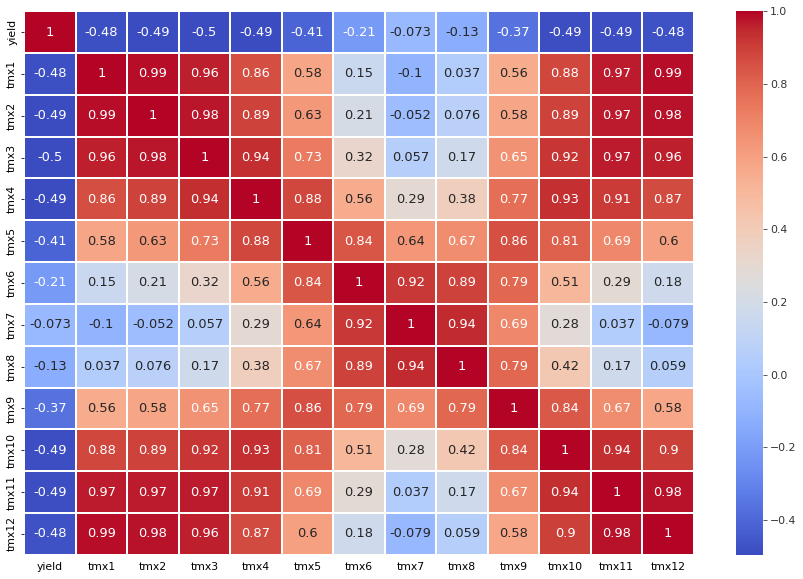

In [56]:
df_cor = df_all[df_all.crop == 'maize']
df_cor = get_var(df_cor, 'tmx')
plot_col()
sns.heatmap(df_cor.corr(), cmap = 'coolwarm', annot = True, linewidth = 2)

<AxesSubplot:>

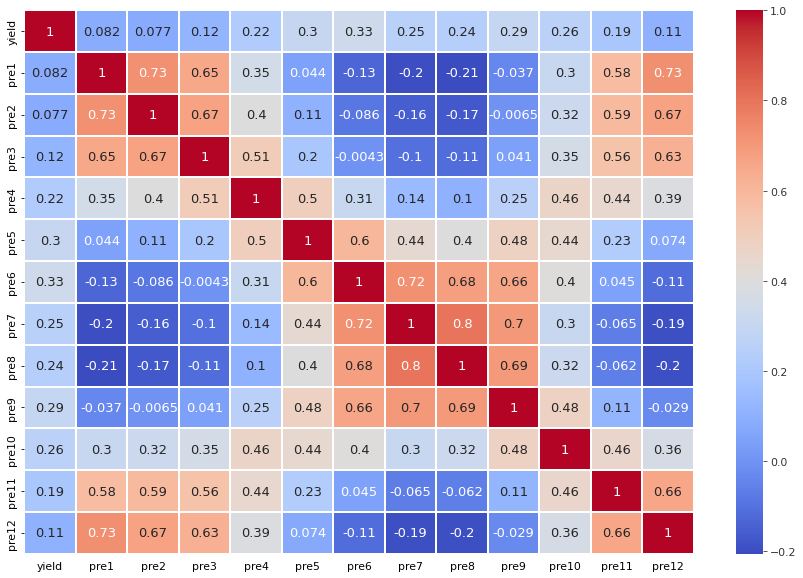

In [60]:
df_cor = df_all[df_all.crop == 'wheat_winter']
df_cor = get_var(df_cor, 'pre')
plot_col()
sns.heatmap(df_cor.corr(), cmap = 'coolwarm', annot = True, linewidth = 2)


<AxesSubplot:>

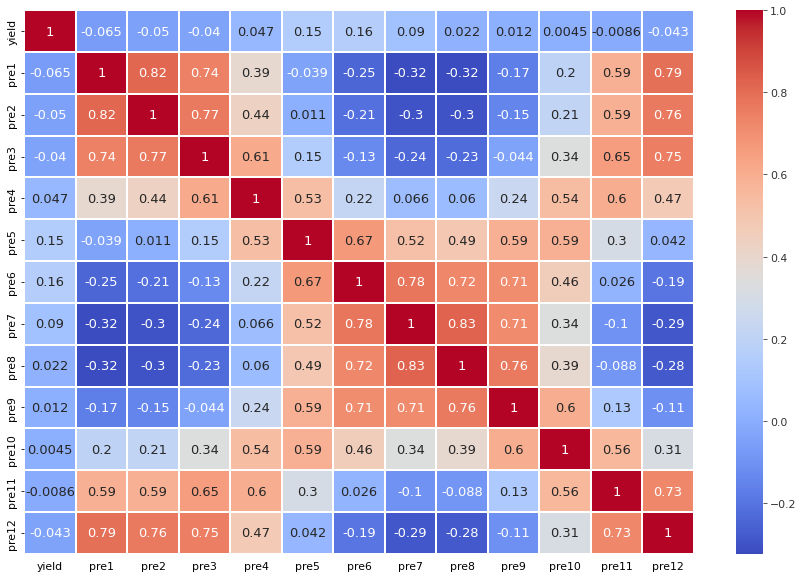

In [58]:
df_cor = df_all[df_all.crop == 'maize']
df_cor = get_var(df_cor, 'pre')
plot_col()
sns.heatmap(df_cor.corr(), cmap = 'coolwarm', annot = True, linewidth = 2)


<AxesSubplot:>

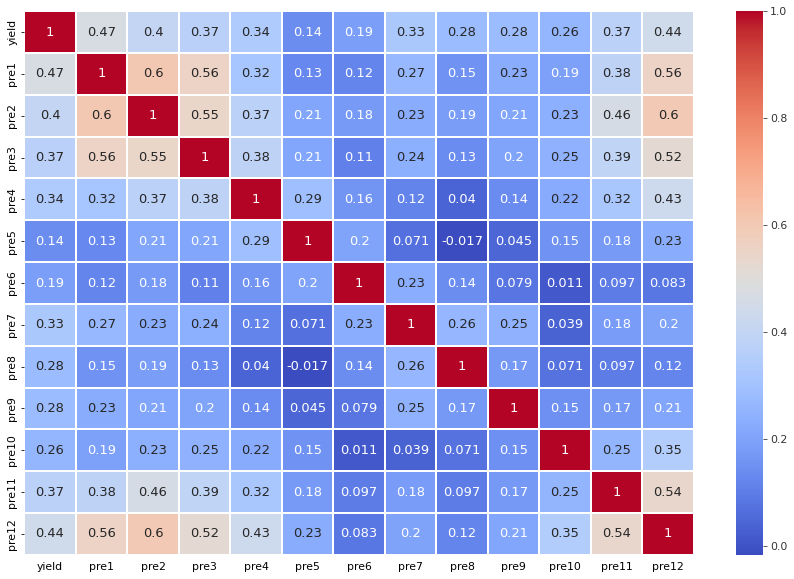

In [69]:
df_cor = df_all[df_all.crop == 'soy']
df_cor = geo_subset(df_cor, 'US')
df_cor = get_var(df_cor, 'pre')
plot_col()
sns.heatmap(df_cor.corr(), cmap = 'coolwarm', annot = True, linewidth = 2)


<AxesSubplot:>

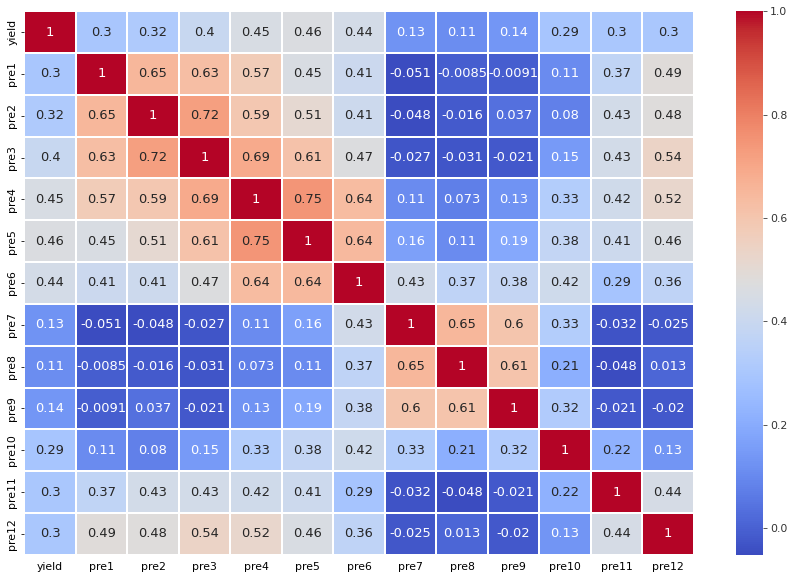

In [70]:
df_cor = df_all[df_all.crop == 'soy']
df_cor = geo_subset(df_cor, 'china')
df_cor = get_var(df_cor, 'pre')
plot_col()
sns.heatmap(df_cor.corr(), cmap = 'coolwarm', annot = True, linewidth = 2)


<AxesSubplot:>

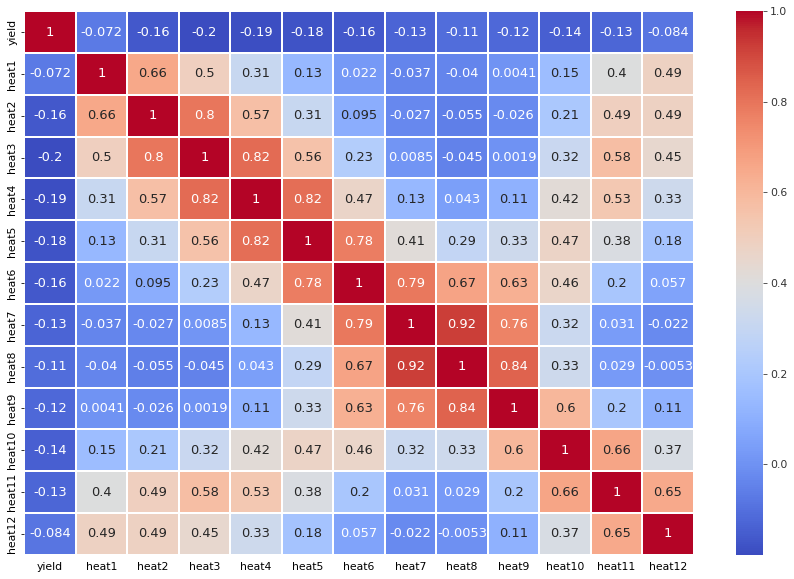

In [86]:
df_cor = df_all[df_all.crop == 'rice']
# df_cor = geo_subset(df_cor, 'US')
df_cor = get_var(df_cor, 'heat')
plot_col()
sns.heatmap(df_cor.corr(), cmap = 'coolwarm', annot = True, linewidth = 2)


<AxesSubplot:>

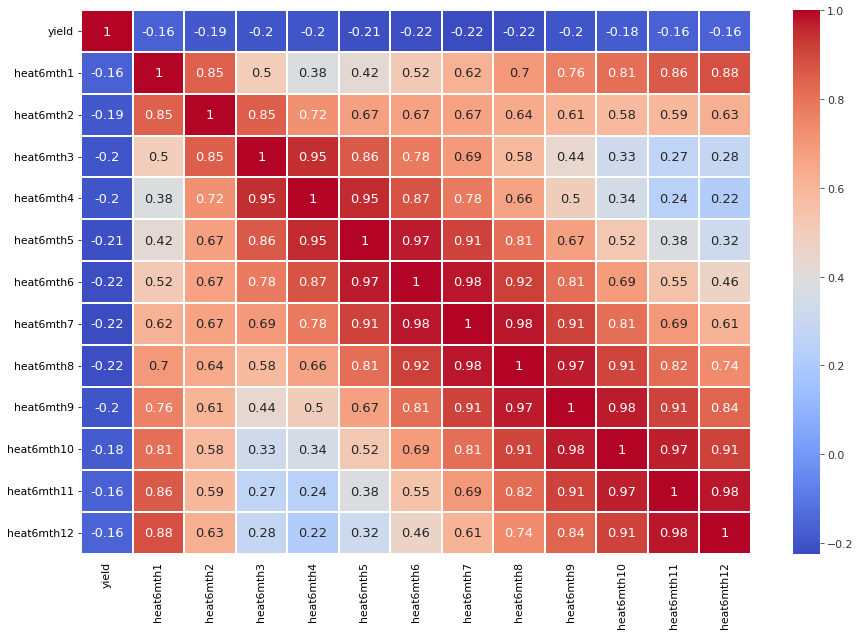

In [87]:
df_cor = df_all[df_all.crop == 'rice']
# df_cor = geo_subset(df_cor, 'US')
df_cor = get_var(df_cor, 'heat6mth')
plot_col()
sns.heatmap(df_cor.corr(), cmap = 'coolwarm', annot = True, linewidth = 2)


In [110]:
df_cor = df_all[((df_all.crop == 'wheat_winter') | (df_all.crop == 'wheat_spring') ) & (df_all.year == 2010)]
make_map(df_cor, 'yield', 'Wheat 2010' ,'Wheat yield tonnes/ha')

In [111]:
df_cor['production'] = df_cor['yield'] * df_cor['harvest']
df_cor['production'] = df_cor['production'].where(df_cor['production'] < 250, 250)
make_map(df_cor, 'production', 'Wheat 2010' ,'Wheat production in tonnes')